In [44]:
# manipulação de dados
import numpy as np
import pandas as pd
from datetime import datetime

# coletar dados
import pandas_datareader as pdr # fred - Federal Reserve Economic Data - USA
import ipeadatapy as ip # Instituto de Pesquisa Econômica Aplicada (IPEA) - Brasil
import yfinance as yf # Yahoo Finance - USA

# análise técnica
import pandas_ta as ta

# visualização de dados
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno # dados faltantes
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

%matplotlib inline

In [45]:
from utils import *

# Dados

Dados sobre o preço do fechamento diário do barril de **petróleo Brent**, em dólares.

- Brent é uma classificação de petróleo extraído do Mar do Norte e comercializado na Bolsa de Londres.
- Sofre influência de fatores como a produção e o transporte de petróleo, a demanda por produtos petrolíferos e a especulação do mercado.
- O preço do petróleo Brent é geralmente medido em dólares americanos por barril, onde cada barril contém 159 litros.
- Um dos principais tipos de petróleo cru negociados no mercado internacional.
- Assim como o petróleo WTI, o petróleo Brent é usado como referência para o preço do petróleo em todo o mundo.
- Mercados de futuros são onde os comerciantes compram e vendem contratos de petróleo para entrega futura, a partir de um contrato aberto.
- Os contratos de petróleo são negociados em bolsas de *commodities*, como a Intercontinental Exchange (ICE) em Londres.
- O preço do petróleo é regulado pela Organização dos Países Exportadores de Petróleo (OPEP), um cartel de países produtores de petróleo, criado em 1960.

## Coleta de dados - Petróleo Brent

### IPEA - Instituto de Pesquisa Econômica Aplicada

[**IPEA**](http://www.ipeadata.gov.br/Default.aspx) é um portal de dados econômicos do governo brasileiro.<br>
O IPEA disponibiliza dados de diversos indicadores econômicos, como inflação, PIB, taxa de juros, câmbio, entre outros.<br>
Os dados são disponibilizados em formato de séries temporais, que podem ser baixados em formato CSV.<br>
O IPEA também disponibiliza um *API* para acesso aos dados, que pode ser acessado através de requisições *HTTP*.

```python
!pip install ipeadatapy
import ipeadatapy as ipea

ipea.list_series() # lista de séries disponíveis

In [46]:
# código da tabela com preços do brent no IPEA
ipea_table_code = 'EIA366_PBRENT366'

# coleta de dados
ipea_brent_df = ip.timeseries(ipea_table_code)[['VALUE (US$)']]

ipea_brent_df.columns = ['value']

ipea_brent_df.index.name = 'date'

ipea_brent_df

,value
date,
1986-01-04,NaN
1986-01-05,NaN
1986-01-06,NaN
1986-01-07,NaN
1986-01-08,NaN
...,...
2024-05-07,82.69
2024-05-08,82.44
2024-05-09,83.27


In [47]:
ipea_brent_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 13439 entries, 1986-01-04 to 2024-05-13
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   value   11169 non-null  float64
dtypes: float64(1)
memory usage: 210.0 KB


In [48]:
# last not nan day
last_day_ipea = ipea_brent_df.query('value.notna()').index.max()

# first not nan day
first_day_ipea = ipea_brent_df.query('value.notna()').index.min()

print(f'First day: {first_day_ipea}')
print(f'Last day: {last_day_ipea}')

ipea_brent_df = ipea_brent_df.loc[first_day_ipea:last_day_ipea]

ipea_brent_df

First day: 1987-05-20 00:00:00
Last day: 2024-05-13 00:00:00


,value
date,
1987-05-20,18.63
1987-05-21,18.45
1987-05-22,18.55
1987-05-23,NaN
1987-05-24,NaN
...,...
2024-05-07,82.69
2024-05-08,82.44
2024-05-09,83.27


In [49]:
# índices duplicados
ipea_brent_df[ipea_brent_df.index.duplicated(keep=False)]

,value
date,


In [50]:
# porcentagem de valores nulos
ipea_brent_df.isnull().sum() / ipea_brent_df.shape[0] * 100

value    13.686244
dtype: float64

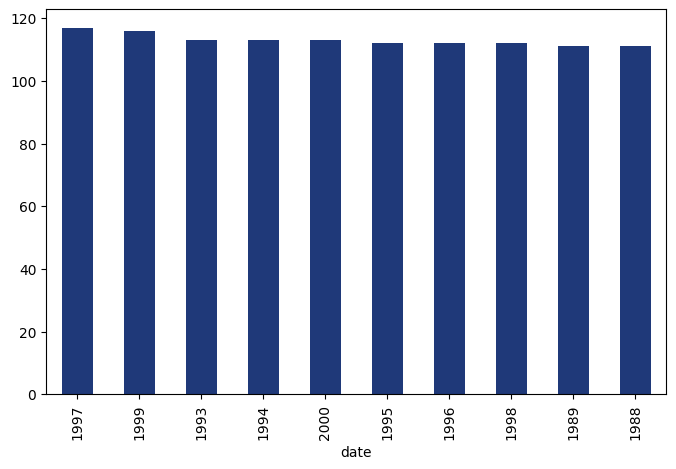

In [51]:
# localização dos valores nulos por ano
ipea_brent_df[ipea_brent_df['value'].isnull()]\
    .index.year.value_counts().head(10)\
        .plot(kind='bar', figsize=(8, 5), color='#1f3979');

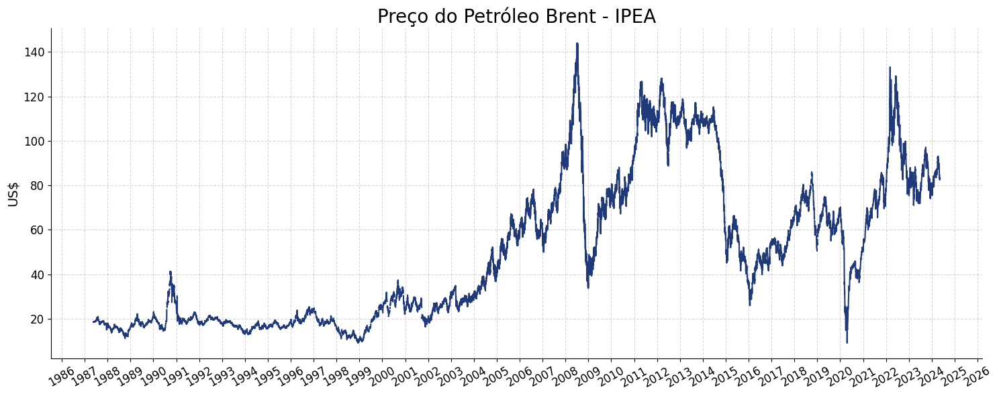

In [52]:
plot_series(ipea_brent_df, 
            'value', 
            title='Preço do Petróleo Brent - IPEA',
            ylabel='US$')

### FRED - Federal Reserve Economic Data

O [**FRED**](https://fred.stlouisfed.org/) - Federal Reserve Economic Data - é um banco de dados econômicos mantido pelo Federal Reserve Bank of St. Louis, nos EUA. Ele contém uma vasta quantidade de dados econômicos, incluindo séries temporais de preços de *commodities*, como o [**petróleo Brent**](https://fred.stlouisfed.org/series/DCOILBRENTEU).

Os dados podem ser baixados em formato CSV ou Excel, e o FRED disponibiliza um *API* para acesso aos dados, que pode ser acessado através de requisições *HTTP*.

```python
!pip install pandas_datareader
import pandas_datareader as pdr

In [53]:
# código do brent no FRED
brent_code = 'dcoilbrenteu'

# primeiro dia com dados disponíveis
start = datetime(1987, 5, 20)
# data atual
end = datetime.today()

# coleta de dados
fred_brent_df = pdr.get_data_fred(brent_code, start, end, freq='d')

fred_brent_df.index.name = 'date'

fred_brent_df

,dcoilbrenteu
date,
1987-05-20,18.63
1987-05-21,18.45
1987-05-22,18.55
1987-05-25,18.60
1987-05-26,18.63
...,...
2024-05-07,82.69
2024-05-08,82.44
2024-05-09,83.27


In [54]:
# diferença entre as datas
fred_brent_df.index.to_series()\
    .diff()\
        .sort_index(ascending=False).\
            value_counts(normalize=True)

date
1 days    0.799959
3 days    0.200041
Name: proportion, dtype: float64

In [55]:
# índices duplicados
fred_brent_df[fred_brent_df.index.duplicated(keep=False)]

,dcoilbrenteu
date,


In [56]:
# porcentagem de valores nulos
fred_brent_df.isnull().sum() / fred_brent_df.shape[0] * 100

dcoilbrenteu    2.746399
dtype: float64

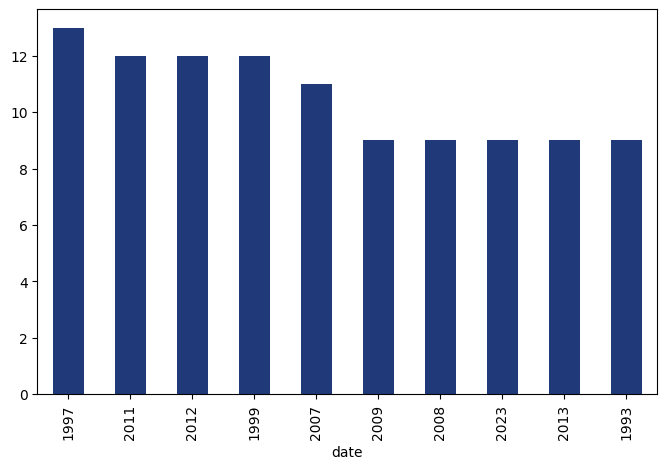

In [57]:
# localização dos valores nulos por ano
fred_brent_df[fred_brent_df['dcoilbrenteu'].isnull()]\
    .index.year.value_counts().head(10)\
        .plot(kind='bar', figsize=(8, 5), color='#1f3979');

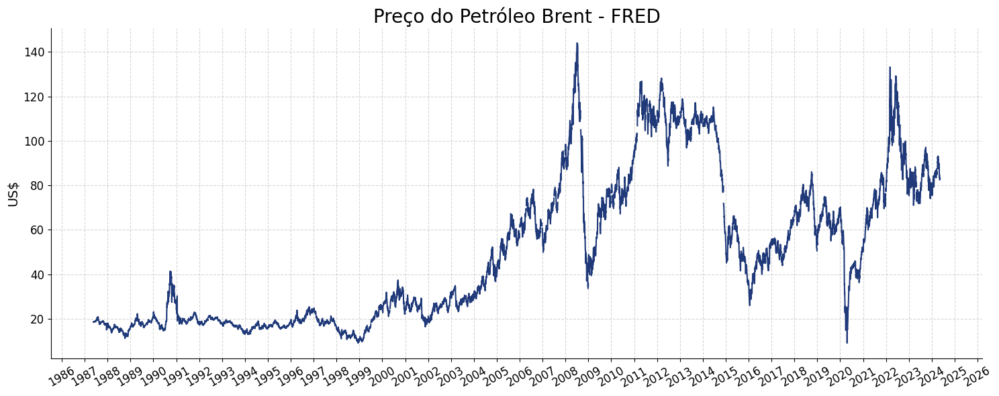

In [58]:
plot_series(fred_brent_df, 
            brent_code, 
            title='Preço do Petróleo Brent - FRED', 
            ylabel='US$')

### Bolsas de valores, Ouro & Ações de Petroleiras - Yahoo Finance

O [**Yahoo Finance**](https://finance.yahoo.com/) é um portal de notícias e dados financeiros, que disponibiliza cotações de ações, índices de bolsas de valores, preços de *commodities*, entre outros.

Os dados podem ser baixados diretamente do site ou através de uma *API* não oficial, como a [**yfinance**](https://pypi.org/project/yfinance/).

```python
# pip install yfinance
import yfinance as yf
```

In [59]:
# códigos negociados no mercado da bolsa, com índices representativos, ouro e petrolíferas
tickers_dict = {'^GSPC': 'sp500',      # unidade: pontos
                '^IXIC': 'nasdaq',     # unidade: pontos
                '^DJI': 'dowjones',    # unidade: pontos
                'GC=F': 'gold',        # unidade: USD/onça
                'XOM': 'exxon',        # unidade: USD
                'BP': 'bp',            # unidade: USD
               }

# coleta de dados
yfinance_df = get_yfinance_prices(tickers_dict, start, end)

yfinance_df

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


Error downloading dowjones


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


,sp500,nasdaq,dowjones,gold,exxon,bp
date,,,,,,
1987-05-20,278.209991,406.600006,NaN,NaN,10.921875,18.500000
1987-05-21,280.170013,408.500000,NaN,NaN,10.906250,18.687500
1987-05-22,282.160004,407.399994,NaN,NaN,10.843750,18.468750
1987-05-26,289.109985,411.399994,NaN,NaN,10.984375,18.500000
1987-05-27,288.730011,412.600006,NaN,NaN,10.937500,18.406250
...,...,...,...,...,...,...
2024-05-13,5221.419922,16388.240234,39431.511719,2336.100098,117.910004,38.099998
2024-05-14,5246.680176,16511.179688,39558.109375,2353.399902,117.669998,37.959999
2024-05-15,5308.149902,16742.390625,39908.000000,2388.699951,118.580002,37.759998


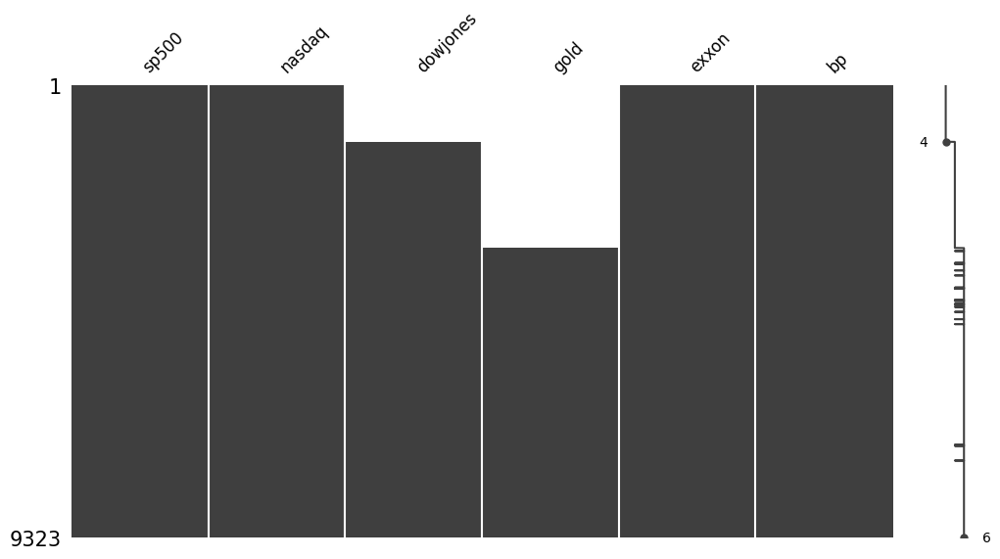

In [ ]:
# # valores nulos
msno.matrix(yfinance_df,
            figsize=(12, 6),
            fontsize=12)
plt.show()

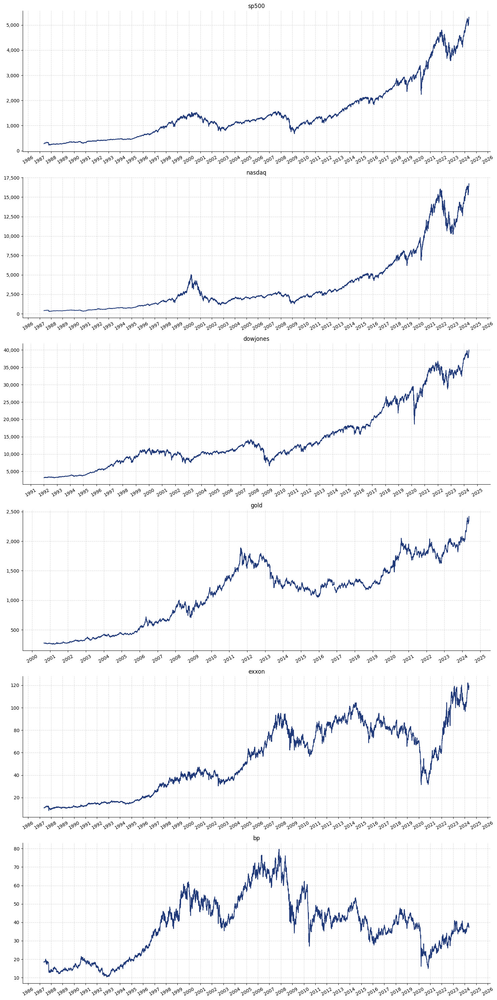

In [ ]:
# plotar todas as séries juntas
plot_series(yfinance_df,
            [name for name in tickers_dict.values()],
            title='Preços de Ativos Negociados no Mercado de Ações',
            ylabel='US$',
            same_ax=False)

### Criando único dataframe com os dados

In [ ]:
# séries brent
brent_df = pd.concat([fred_brent_df, ipea_brent_df], axis=1)

# renomear colunas
brent_df.columns = ['fred', 'ipea']

# se fred é nulo, preencher com ipea; se ipea é nulo, preencher com fred
brent_df['brent'] = np.where(brent_df['fred'].notna(), 
                             brent_df['fred'], 
                             brent_df['ipea'])

# deletar colunas
brent_df.drop(columns=['fred', 'ipea'], inplace=True)

brent_df

,brent
date,
1987-05-20,18.63
1987-05-21,18.45
1987-05-22,18.55
1987-05-23,NaN
1987-05-24,NaN
...,...
2024-05-07,82.69
2024-05-08,82.44
2024-05-09,83.27


In [ ]:
# porcentagem de valores nulos
brent_df.isnull().sum() / brent_df.shape[0] * 100

brent    13.831099
dtype: float64

In [ ]:
# finais de semana
brent_df.index.to_series().dt.day_name().value_counts()

date
Wednesday    1930
Thursday     1930
Friday       1930
Monday       1930
Tuesday      1929
Saturday     1667
Sunday       1662
Name: count, dtype: int64

In [ ]:
# filtrar finais de semana e calcular porcentagem de valores nulos
brent_df[brent_df.index.to_series().dt.day_name().isin(['Saturday', 'Sunday'])]\
    .isnull().sum()\
         / brent_df[brent_df.index.to_series().dt.day_name().isin(['Saturday', 'Sunday'])]\
             .shape[0] * 100

brent    49.023731
dtype: float64

In [ ]:
# criar calendário
last_year = pd.to_datetime(brent_df.index.max()).year + 1
first_year = pd.to_datetime(brent_df.index.min()).year - 1

# lista de anos
year_list = [str(int(i)) for i in np.arange(first_year, last_year)]

df = make_calendars(year_list, drop_index=True)

# coluna data como índice
df.set_index('date', inplace=True)

df

,month,year,weekday,is_weekday,is_holiday,is_holiday_week
date,,,,,,
1986-01-01,January,1986,Wednesday,1,1,1
1986-01-02,January,1986,Thursday,1,0,1
1986-01-03,January,1986,Friday,1,0,1
1986-01-04,January,1986,Saturday,0,0,1
1986-01-05,January,1986,Sunday,0,0,0
...,...,...,...,...,...,...
2024-12-27,December,2024,Friday,1,0,1
2024-12-28,December,2024,Saturday,0,0,1
2024-12-29,December,2024,Sunday,0,0,0


In [ ]:
# mesclar com yfinance
df = df.merge(yfinance_df, how='left', left_index=True, right_index=True)

# mesclar com brent
df = df.merge(brent_df, how='left', left_index=True, right_index=True)

# primeira data = primeiro dia com valores em brent
first_day = df.query('brent.notna()').index.min()

# última linha = último dia com valores em brent
last_day = df.query('brent.notna()').index.max()

# a partir da primeira data e apenas dias úteis até a última data com valores em brent
df = df[(df.index >= first_day) & (df.index <= last_day) & (df.index.dayofweek < 5)]

df

,month,year,weekday,is_weekday,is_holiday,is_holiday_week,sp500,nasdaq,dowjones,gold,exxon,bp,brent
date,,,,,,,,,,,,,
1987-05-20,May,1987,Wednesday,1,0,0,278.209991,406.600006,NaN,NaN,10.921875,18.500000,18.63
1987-05-21,May,1987,Thursday,1,0,0,280.170013,408.500000,NaN,NaN,10.906250,18.687500,18.45
1987-05-22,May,1987,Friday,1,0,1,282.160004,407.399994,NaN,NaN,10.843750,18.468750,18.55
1987-05-25,May,1987,Monday,1,1,1,NaN,NaN,NaN,NaN,NaN,NaN,18.60
1987-05-26,May,1987,Tuesday,1,0,1,289.109985,411.399994,NaN,NaN,10.984375,18.500000,18.63
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-07,May,2024,Tuesday,1,0,0,5187.700195,16332.559570,38884.261719,2315.199951,116.169998,37.580002,82.69
2024-05-08,May,2024,Wednesday,1,0,0,5187.669922,16302.759766,39056.390625,2313.600098,116.150002,37.529999,82.44
2024-05-09,May,2024,Thursday,1,0,0,5214.080078,16346.259766,39387.761719,2332.100098,118.440002,38.040001,83.27


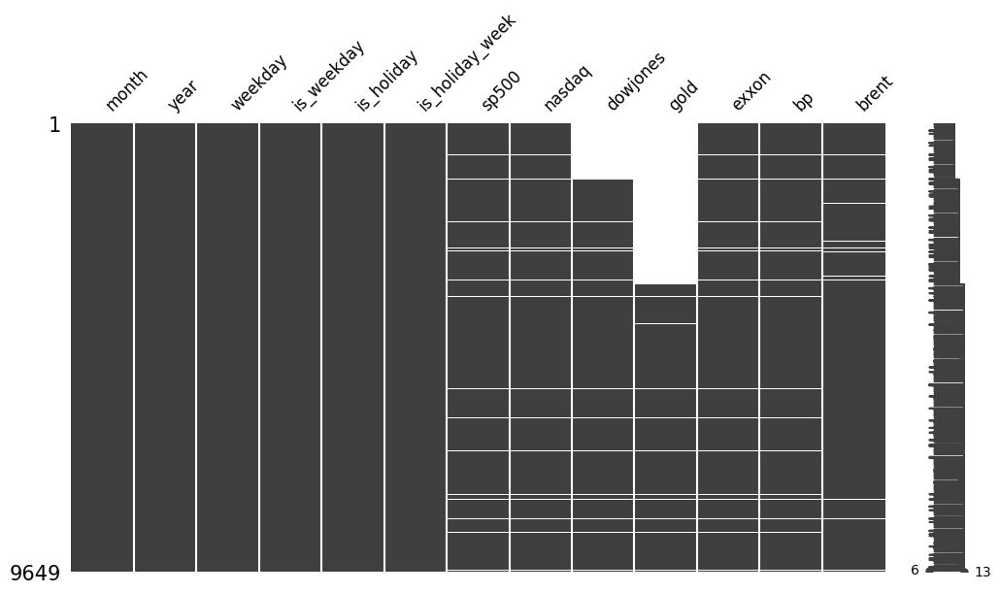

In [ ]:
msno.matrix(df,
            figsize=(12, 6),
            fontsize=12);

In [ ]:
# porcentagem de valores nulos por coluna
df.isnull().sum() / df.shape[0] * 100

month               0.000000
year                0.000000
weekday             0.000000
is_weekday          0.000000
is_holiday          0.000000
is_holiday_week     0.000000
sp500               3.420044
nasdaq              3.420044
dowjones           15.524925
gold               38.408125
exxon               3.420044
bp                  3.420044
brent               1.689294
dtype: float64

In [ ]:
# manter apenas colunas com menos de 4% de valores nulos
df = df.loc[:, df.isnull().mean() < .10]

df

,month,year,weekday,is_weekday,is_holiday,is_holiday_week,sp500,nasdaq,exxon,bp,brent
date,,,,,,,,,,,
1987-05-20,May,1987,Wednesday,1,0,0,278.209991,406.600006,10.921875,18.500000,18.63
1987-05-21,May,1987,Thursday,1,0,0,280.170013,408.500000,10.906250,18.687500,18.45
1987-05-22,May,1987,Friday,1,0,1,282.160004,407.399994,10.843750,18.468750,18.55
1987-05-25,May,1987,Monday,1,1,1,NaN,NaN,NaN,NaN,18.60
1987-05-26,May,1987,Tuesday,1,0,1,289.109985,411.399994,10.984375,18.500000,18.63
...,...,...,...,...,...,...,...,...,...,...,...
2024-05-07,May,2024,Tuesday,1,0,0,5187.700195,16332.559570,116.169998,37.580002,82.69
2024-05-08,May,2024,Wednesday,1,0,0,5187.669922,16302.759766,116.150002,37.529999,82.44
2024-05-09,May,2024,Thursday,1,0,0,5214.080078,16346.259766,118.440002,38.040001,83.27


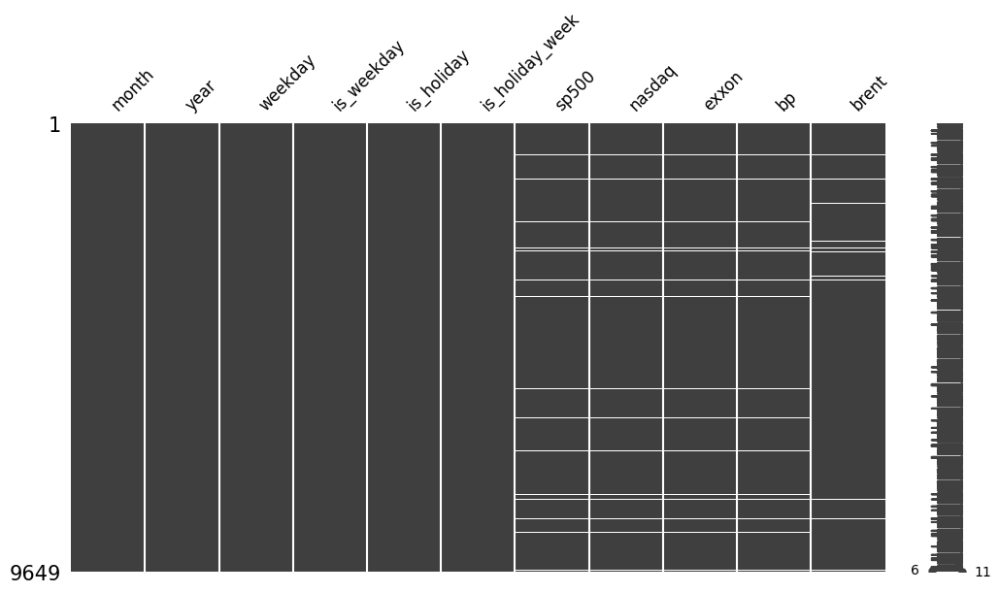

In [ ]:
msno.matrix(df,
            figsize=(12, 6),
            fontsize=12);

In [ ]:
#  preencher valores nulos com o último valor válido
df = df.bfill().ffill()

df

,month,year,weekday,is_weekday,is_holiday,is_holiday_week,sp500,nasdaq,exxon,bp,brent
date,,,,,,,,,,,
1987-05-20,May,1987,Wednesday,1,0,0,278.209991,406.600006,10.921875,18.500000,18.63
1987-05-21,May,1987,Thursday,1,0,0,280.170013,408.500000,10.906250,18.687500,18.45
1987-05-22,May,1987,Friday,1,0,1,282.160004,407.399994,10.843750,18.468750,18.55
1987-05-25,May,1987,Monday,1,1,1,289.109985,411.399994,10.984375,18.500000,18.60
1987-05-26,May,1987,Tuesday,1,0,1,289.109985,411.399994,10.984375,18.500000,18.63
...,...,...,...,...,...,...,...,...,...,...,...
2024-05-07,May,2024,Tuesday,1,0,0,5187.700195,16332.559570,116.169998,37.580002,82.69
2024-05-08,May,2024,Wednesday,1,0,0,5187.669922,16302.759766,116.150002,37.529999,82.44
2024-05-09,May,2024,Thursday,1,0,0,5214.080078,16346.259766,118.440002,38.040001,83.27


## Análise Exploratória de Dados

Ao longo dos 37 anos de registro, o valor do dinheiro teve grandes alterações. Também, mudou o comportamento do mercado e a tecnologia evoluiu. Sem levar em conta tais componentes, ainda é possível enxergar os marcos importantes do período através do comportamento expressado no gráfico acima:

- A mínima do período data de 10 de Dezembro de 1998, com preço equivalente a US$9.10.
- A segunda menor mínima ocorreu na Pandemia de COVID-19, em 21 de Abril de 2020, com preço em US$9.12.
- Em 2008, o preço do barril de petróleo Brent atingiu o valor recorde de US$143.95. Com grande recessão, o preço caiu para US$33.73 no mesmo ano. A variação agressiva foi de -326.78%.
- As guerras entre EUA e Iraque (2003) e entre Rússia e Ucrânia (2022) também impactaram no preço do petróleo - por questões de oferta e demanda, dificuldades na produção e circulação de mercadorias, além da especulação do mercado.

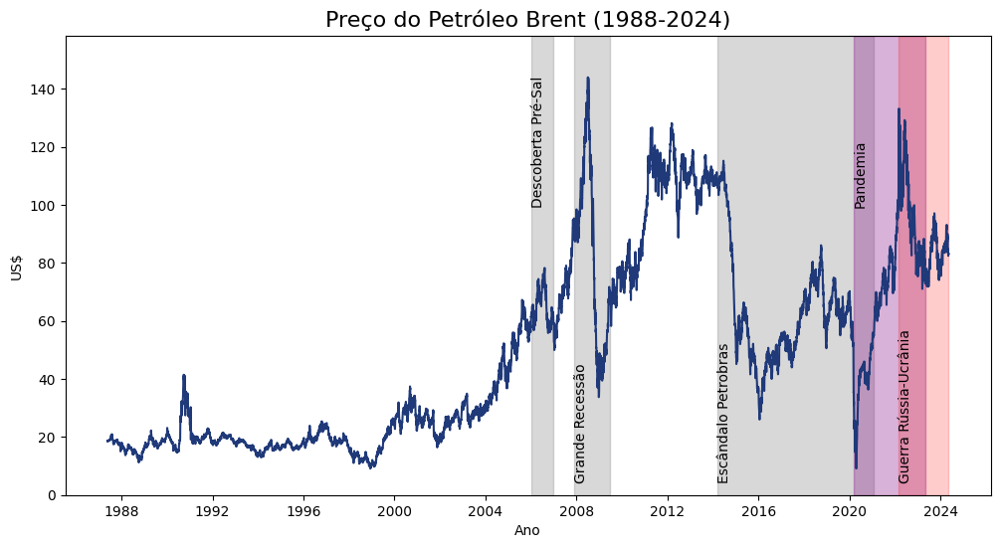

In [ ]:
# plotar linha do tempo
fig, ax = plt.subplots(figsize=(12, 6))
sns.lineplot(data=df, x=df.index, y='brent', ax=ax, color='#1f3979')
# marcar 2006 em área como descoberta pré-sal
ax.axvspan('2006-01-01', '2006-12-31', color='grey', alpha=0.3)
# texto para descoberta pré-sal
ax.text(pd.to_datetime('2006-01-01'), 100, 'Descoberta Pré-Sal', rotation=90)
# adicionar grande recessão
ax.axvspan('2007-12-01', '2009-06-30', color='grey', alpha=0.3)
# texto para grande recessão
ax.text(pd.to_datetime('2007-12-01'), 5, 'Grande Recessão', rotation=90)
# adicionar escândalo Petrobras
ax.axvspan('2014-03-17', '2021-02-01', color='grey', alpha=0.3)
# texto para escândalo Petrobras
ax.text(pd.to_datetime('2014-03-17'), 5, 'Escândalo Petrobras', rotation=90)
# adicionar pandemia
ax.axvspan('2020-03-11', '2023-05-05', color='purple', alpha=0.3)
# texto para pandemia
ax.text(pd.to_datetime('2020-03-11'), 100, 'Pandemia', rotation=90)
# adicionar guerra Rússia-Ucrânia (verificar data)
ax.axvspan('2022-02-24', df.index.max(), color='red', alpha=0.2)
# texto para guerra Rússia-Ucrânia
ax.text(pd.to_datetime('2022-02-24'), 5, 'Guerra Rússia-Ucrânia', rotation=90)
# adicionar título
ax.set_title('Preço do Petróleo Brent (1988-2024)', fontsize=16)
# ylabel
ax.set_ylabel('US$')
# xlabel
ax.set_xlabel('Ano')
# y lim + 10%
ax.set_ylim(0, df['brent'].max() * 1.10)
plt.show()

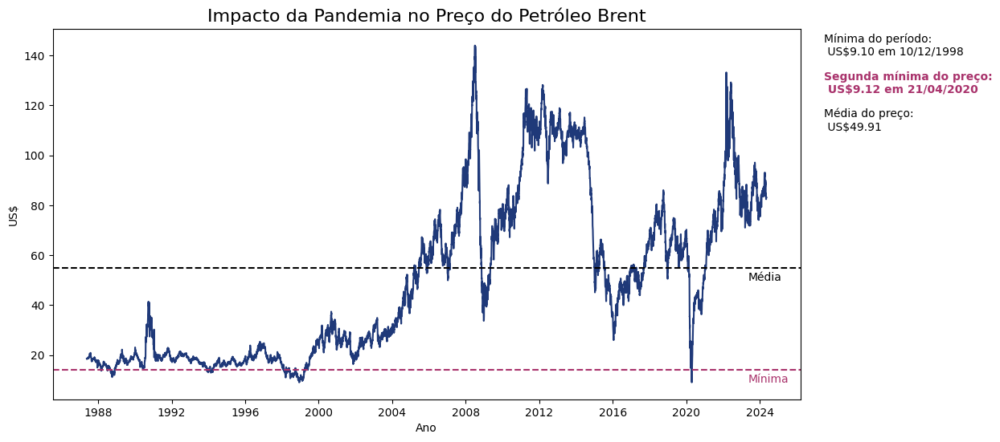

In [ ]:
fig, ax = plt.subplots(figsize=(12, 6))
sns.lineplot(data=df, x=df.index, y='brent', ax=ax, color='#1f3979')
# linha com mínima
ax.axhline(df['brent'].min()+5, linestyle='--', color='#A9336C')
ax.text(19500, df['brent'].min(), 'Mínima', color='#A9336C')
# linha com média
ax.axhline(df['brent'].mean()+5, linestyle='--', color='black')
ax.text(19500, df['brent'].mean(), 'Média', color='black')
# adicionar título
ax.set_title('Impacto da Pandemia no Preço do Petróleo Brent', fontsize=16)
# ylabel
ax.set_ylabel('US$')
# texto fora do plot:
# mínima do preço do petróleo: valor e data
min_value = df['brent'].min()
min_date = df['brent'].idxmin().strftime(r'%d/%m/%Y')
# texto com mínima do preço do petróleo
ax.text(21000, 140, f'Mínima do período:\n US${min_value:.2f} em {min_date}', 
        fontsize=10)
# segundo menor valor
sec_min_value = df.query('brent != @min_value')['brent'].min()
sec_min_date = df.query('brent != @min_value')['brent'].idxmin().strftime(r'%d/%m/%Y')
ax.text(21000, 125, f'Segunda mínima do preço:\n US${sec_min_value:.2f} em {sec_min_date}', 
        fontsize=10, color='#A9336C', fontweight='bold')
# texto com média do preço do petróleo
mean_value = df['brent'].mean()
ax.text(21000, 110, f'Média do preço:\n US${mean_value:.2f}', fontsize=10)
# xlabel
ax.set_xlabel('Ano')
plt.show()

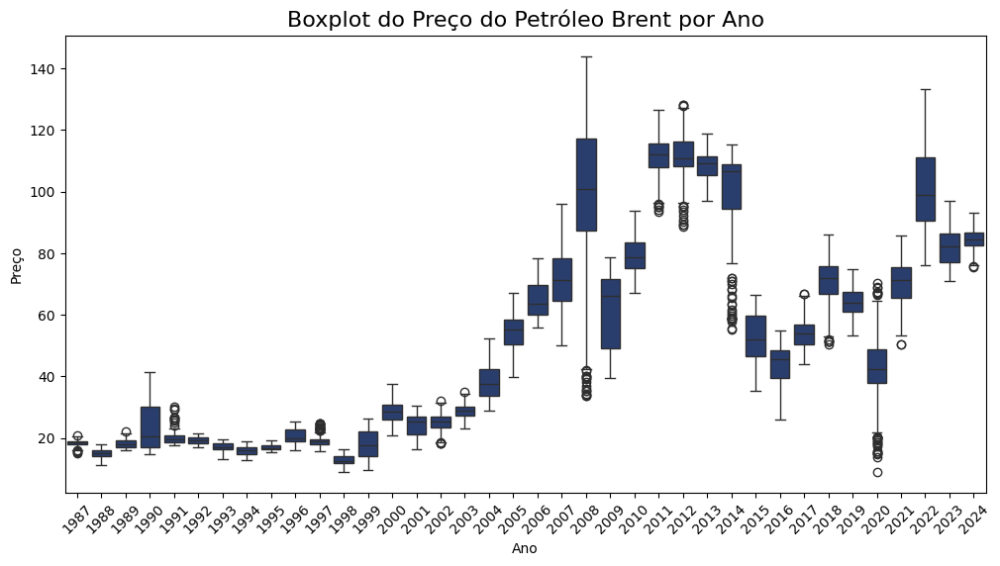

In [ ]:
# brent boxplot por ano
fig, ax = plt.subplots(figsize=(12, 6))
sns.boxplot(data=df, x=df.index.year, y='brent', ax=ax, color='#1f3979')
ax.set_title('Boxplot do Preço do Petróleo Brent por Ano', fontsize=16)
ax.set_xlabel('Ano')
ax.set_ylabel('Preço')
# xticks
plt.xticks(rotation=45)
plt.show()

Maior variação nos meses 06 e 07, principalmente nas duas últimas semanas:

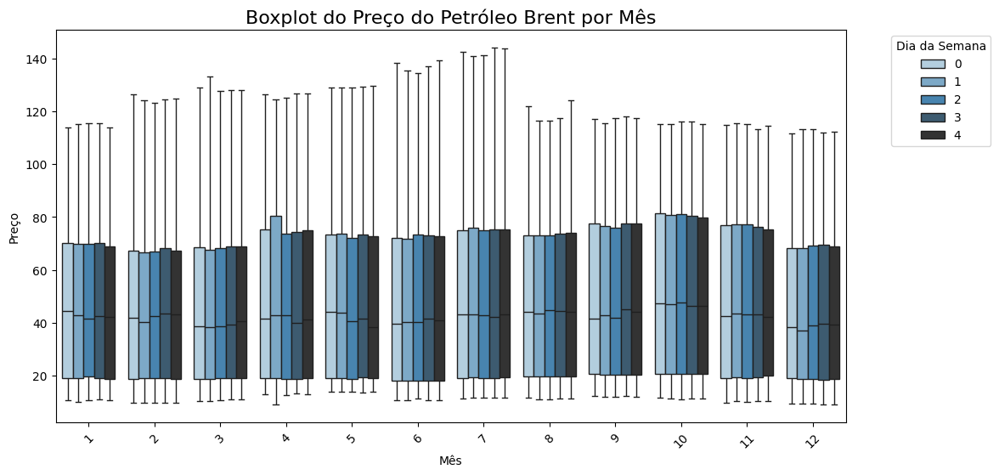

In [ ]:
# boxplot por mês, ressaltando os dias da semana
fig, ax = plt.subplots(figsize=(12, 6))
sns.boxplot(data=df, x=df.index.month, y='brent', hue=df.index.weekday, 
            ax=ax, palette='Blues_d')
ax.set_title('Boxplot do Preço do Petróleo Brent por Mês', fontsize=16)
plt.legend(title='Dia da Semana', 
           bbox_to_anchor=(1.05, 1), loc='upper left')
ax.set_xlabel('Mês')
ax.set_ylabel('Preço')
plt.xticks(rotation=45)
plt.show()

### Análise de Série Temporal

Diferenciar uma série temporal é importante por diversos motivos, como:
- Estacionariedade: a média e a variância são constantes ao longo do tempo.
- Sazonalidade: padrões que se repetem em intervalos regulares.
- Redução de tendência: remover tendências e sazonalidades para facilitar a modelagem.

Portanto, o percentual de mudança diária do preço do petróleo Brent é uma métrica importante para entender a volatilidade do mercado.

In [ ]:
diff_cols = ['brent', 'nasdaq', 'sp500', 'exxon', 'bp']

for col in diff_cols:
    # diferença
    df[f'{col}_diff'] = df[col].diff()
    # variação percentual
    df[f'{col}_pct'] = df[col].pct_change() * 100

df

,month,year,weekday,is_weekday,is_holiday,is_holiday_week,sp500,nasdaq,exxon,bp,...,brent_diff,brent_pct,nasdaq_diff,nasdaq_pct,sp500_diff,sp500_pct,exxon_diff,exxon_pct,bp_diff,bp_pct
date,,,,,,,,,,,,,,,,,,,,,
1987-05-20,May,1987,Wednesday,1,0,0,278.209991,406.600006,10.921875,18.500000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1987-05-21,May,1987,Thursday,1,0,0,280.170013,408.500000,10.906250,18.687500,...,-0.18,-0.966184,1.899994,0.467288,1.960022,0.704512,-0.015625,-0.143062,0.187500,1.013514
1987-05-22,May,1987,Friday,1,0,1,282.160004,407.399994,10.843750,18.468750,...,0.10,0.542005,-1.100006,-0.269279,1.989990,0.710280,-0.062500,-0.573066,-0.218750,-1.170569
1987-05-25,May,1987,Monday,1,1,1,289.109985,411.399994,10.984375,18.500000,...,0.05,0.269542,4.000000,0.981836,6.949982,2.463135,0.140625,1.296830,0.031250,0.169205
1987-05-26,May,1987,Tuesday,1,0,1,289.109985,411.399994,10.984375,18.500000,...,0.03,0.161290,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-07,May,2024,Tuesday,1,0,0,5187.700195,16332.559570,116.169998,37.580002,...,0.00,0.000000,-16.690430,-0.102087,6.959961,0.134343,-0.580002,-0.496790,-1.459999,-3.739752
2024-05-08,May,2024,Wednesday,1,0,0,5187.669922,16302.759766,116.150002,37.529999,...,-0.25,-0.302334,-29.799805,-0.182456,-0.030273,-0.000584,-0.019997,-0.017213,-0.050003,-0.133058
2024-05-09,May,2024,Thursday,1,0,0,5214.080078,16346.259766,118.440002,38.040001,...,0.83,1.006793,43.500000,0.266826,26.410156,0.509095,2.290001,1.971589,0.510002,1.358919


In [ ]:
layout = dict(
    title='Preço do Petróleo Brent - Original, Diferença e Variação (%)',
    hovermode='x unified',  # x unificado
    template='plotly_dark',
    width=1000, height=800,
    grid=dict(rows=3, columns=1)
)

data = [
    go.Scatter(x=df.index, y=df['brent'], name='Original', xaxis='x', yaxis='y1'),
    go.Scatter(x=df.index, y=df['brent_diff'], name='Diferença', xaxis='x', yaxis='y2'),
    go.Scatter(x=df.index, y=df['brent_pct'], name='Variação (%)', xaxis='x', yaxis='y3')
]

fig = go.Figure(data=data, layout=layout)

fig.show()

Abaixo, o teste de estacionariedade de Dickey-Fuller aponta para uma série estacionária:

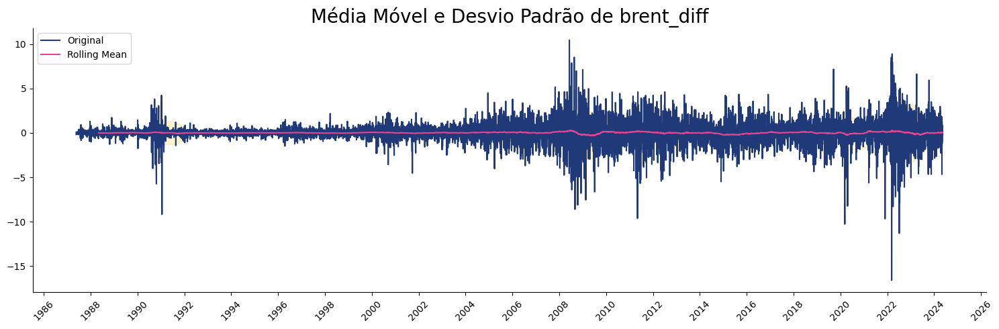

Test Statistic                -1.484204e+01
p-value                        1.830882e-27
#Lags Used                     3.500000e+01
Number of Observations Used    9.612000e+03
Critical Value (1%)           -3.431031e+00
Critical Value (5%)           -2.861841e+00
Critical Value (10%)          -2.566930e+00
dtype: float64
----------------------------------------
Results of Dickey-Fuller Test:
The Test Statistic is lower than the Critical Value (1%). The series is stationary.
The p-value is lower than 0.05. The series is stationary.


In [ ]:
# teste de estacionariedade para brent_diff
stationarity_test(df.dropna(), 'brent_diff')

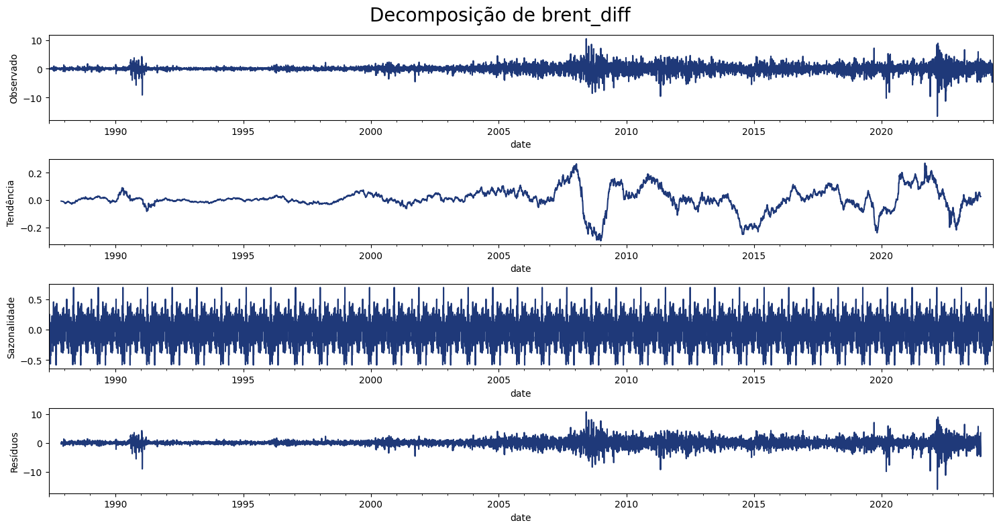

In [ ]:
# decomposição de séries temporais
# brent
plot_decomposition(df.dropna(), 'brent_diff', period=252, model='additive')

O histograma da série diferenciada é mais próximo de uma distribuição normal do que a série original.

In [ ]:
# distplot for each, same subplot
fig = make_subplots(rows=3, cols=1)

fig.add_trace(ff.create_distplot([df['brent']], ['brent'], bin_size=1).data[0], row=1, col=1)
fig.add_trace(ff.create_distplot([df['brent_diff'].dropna()], ['brent_diff'], bin_size=1).data[0], row=2, col=1)
fig.add_trace(ff.create_distplot([df['brent_pct'].dropna()], ['brent_pct'], bin_size=1).data[0], row=3, col=1)

fig.update_layout(width=1000, height=800,
                    title='Preço Brent, Diferença e Variação',
                    template='plotly_dark')

fig.show()

In [ ]:
# histograma das diferenças - brent
fig = px.histogram(df, x='brent_diff', nbins=100,
                     title='Histograma das diferenças do Brent',
                        template='plotly_dark',
                        marginal='box',
                        histnorm='probability density',
                        labels={'brent_diff': ''}
                        )

fig.update_yaxes(title='')

fig.update_layout(width=1000, height=600)

fig.show()

Porém, de acordo com o teste estatítico Kolmorogov-Smirnov, a série diferenciada **não** segue uma distribuição normal.

In [ ]:
# teste de normalidade
ks_results = normality_test(df['brent_diff'].dropna())

# export dict
ks_results

{'statistic': 0.09995756620241947,
 'p-value': 2.2733791982436216e-84,
 'alpha': 0.05,
 'normal': False}

O gráfico abaixo mostra a variação do preço do barril de petróleo Brent ao longo do tempo. Note como as maiores variações correspondem aos meses de Maio (ex. 2008, 2009, 2020 e 2022). As 2 maiores baixas o preço, por sua vez, correspondem a Outubro/2008 (Grande Recessão) e Março/2020 (Pandemia de COVID-19).

In [ ]:
fig = px.imshow(df.pivot_table(index='year', columns=df.index.month, values='brent_diff'),
                labels=dict(color='Variação Brent'),
                title='Variação do Preço do Brent ao longo do tempo',
                color_continuous_scale='RdBu',
                width=800, height=1000,
                template='plotly_dark')

# mostrar meses 1 por 1
fig.update_xaxes(tickvals=list(range(1, 13)),
                 ticktext=['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'],
                 side='top', title='')

fig.update_yaxes(title='')

fig.show()

In [ ]:
# Percentual de variação do Brent nos últimos 10 anos
print('Média de 2014 a 2019: ', df.query('year >= "2014" and year <= "2019"').brent_pct.mean())
print('Desvio Padrão de 2014 a 2019: ', df.query('year >= "2014" and year <= "2019"').brent_pct.std())
print('-'*50)
print('Média de 2020 a 2021: ', df.query('year >= "2020" and year <= "2021"').brent_pct.mean())
print('Desvio Padrão de 2020 a 2021: ', df.query('year >= "2020" and year <= "2021"').brent_pct.std())
print('-'*50)
print('Média de 2022 a 2024: ', df.query('year >= "2022" and year <= "2024"').brent_pct.mean())
print('Desvio Padrão de 2022 a 2024: ', df.query('year >= "2022" and year <= "2024"').brent_pct.std())

Média de 2014 a 2019:  -0.007717365992994763
Desvio Padrão de 2014 a 2019:  2.160182219785497
--------------------------------------------------
Média de 2020 a 2021:  0.156945829027264
Desvio Padrão de 2020 a 2021:  5.054013309912778
--------------------------------------------------
Média de 2022 a 2024:  0.04102241521288995
Desvio Padrão de 2022 a 2024:  2.4025323123012163


A plotagem da variável em 3 dimensões, onde mês e ano são eixos temporáis, ajuda a enxergar ciclos de sazonalidade e tendências:

In [ ]:
# brent 3d x ano x mês
fig = px.scatter_3d(df, x=df.index.year, y=df.index.month, z='brent',
                    title='Preço do Petróleo Brent x Ano x Mês',
                    labels={'x': 'Ano', 'y': 'Mês', 'z': 'Preço'},
                    color=df.index.month,
                    color_continuous_scale='PuBu',
                    width=1000, height=800,
                    opacity=0.7,
                    template='plotly_dark')

fig.update_layout(scene=dict(xaxis_title='Ano',
                                yaxis_title='Mês',
                                zaxis_title='Preço (US$)'),
                    coloraxis_colorbar=dict(title='Mês')
                    )

fig.show()

In [ ]:
# brent e outras variáveis
fig = make_subplots(rows=5, cols=1, subplot_titles=diff_cols)

for i in enumerate(diff_cols):
    fig.add_trace(go.Histogram(x=df[col+'_diff'], nbinsx=100, histnorm='probability density'), 
                  row=i[0]+1, col=1)

fig.update_layout(height=1000, width=600, 
                  title_text='Histogramas das diferenças', 
                  showlegend=False,
                  template='plotly_dark')

fig.show()

In [ ]:
# plotar percentuais de mudança
fig = make_subplots(rows=5, cols=1, subplot_titles=diff_cols)

for i in enumerate(diff_cols):
    fig.add_trace(go.Scatter(x=df.index, y=df[col+'_pct'], mode='lines', name=col), 
                  row=i[0]+1, col=1)
    
fig.update_layout(height=1000, width=600,
                    title_text='Percentuais de mudança',
                    showlegend=False,
                    hovermode='x unified',
                    template='plotly_dark')


fig.show()

Apesar de similares, as séries possuem diferenças significativas quando comparadas ao Brent - principalmente em relação à amplitude dos dados:

In [ ]:
labels={'brent_pct': 'Brent',
        'nasdaq_pct': 'Nasdaq',
        'sp500_pct': 'S&P 500',
        'exxon_pct': 'Exxon',
        'bp_pct': 'BP'}

# violino do percentual de mudança
fig = px.violin(df, y=[col+'_pct' for col in diff_cols], box=True, 
                title='Variação Percentual',
                template='plotly_dark')

fig.update_layout(width=1000, height=600)
# renomear labels
fig.update_yaxes(title_text='%')
fig.update_xaxes(title_text='')

fig.show()

### Seleção de Features

A análise de correlação entre as variáveis ajuda a entender como elas se relacionam entre si:

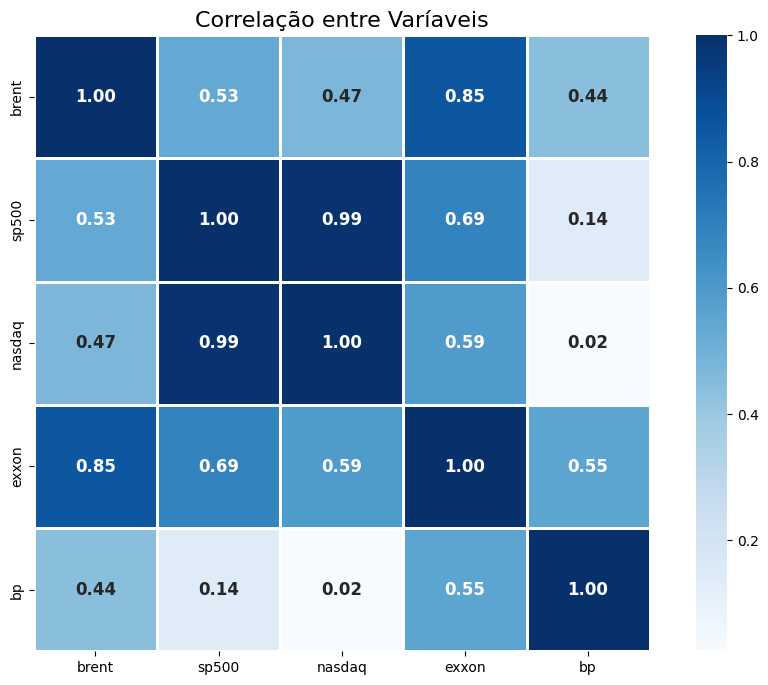

In [ ]:
# últimas 5 colunas contém preços
price_cols = ['brent', 'sp500', 'nasdaq', 'exxon', 'bp']

# correlação
corr = df[price_cols].corr()

fig, ax = plt.subplots(figsize=(12, 8))
sns.heatmap(corr, ax=ax, cmap='Blues',
            annot=True, fmt='.2f',
            linewidths=1, square=True,
            annot_kws={'weight': 'bold', 
                       'fontsize': 12})

# título
ax.set_title('Correlação entre Varíaveis', fontsize=16)

plt.show()

Nenhuma das correlações analisadas acima é negativa.

Para dados econômicos, fatos similares acontecem entre os preços absolutos e, portanto, correlações altas são esperadas. Portanto, também é importante visualizar a correlação entre as séries diferenciadas:

In [ ]:
# correlação das diferenças col + diff
diff_cols = [col for col in df.columns if '_diff' in col]

fig = px.imshow(df[diff_cols].corr().round(2),
                labels=dict(color='Correlação'),
                title='Correlação das Diferenças',
                text_auto=True,
                width=800, height=800,
                color_continuous_scale='Blues',
                template='plotly_dark')

fig.update_xaxes(side='top')
fig.update_layout(font=dict(size=14))

fig.show()

- Correlação entre Brent e Exxon era forte (85%) mas, com as séries diferenciadas passou a ser 33%.
- Nasdaq, que tinha 47% correlação com Brent, passou a ter abaixo de 9%.

In [ ]:
fig = px.scatter(df, x='brent', y='exxon',
                 title='Preços - Brent x Exxon',
                 color=df.index.year,
                 color_continuous_scale='ice',
                 width=800, height=800,
                 template='plotly_dark')

fig.update_layout(coloraxis_colorbar=dict(title='Ano'))

fig.show()

In [ ]:

# plotar diferenças
fig = px.scatter(df, x='brent_diff', y='exxon_diff',
                 labels={'brent_diff':'Brent', 'exxon_diff':'Exxon'},
                 title='Diferenças - Brent x Exxon',
                 color=df.index.year,
                 color_continuous_scale='ice',
                 width=800, height=800,
                 template='plotly_dark')

fig.update_layout(coloraxis_colorbar=dict(title='Ano'))

fig.show()

In [ ]:
# histograma 2d
fig = px.density_heatmap(df, x='exxon_diff', y='brent_diff', 
                         marginal_y='histogram', marginal_x='histogram',
                         title='Diferenças de Preços do Brent e Exxon',
                         labels={'year':'Ano', 'brent_diff':'Brent', 'exxon_diff':'Exxon'},
                         width=1000, height=800,
                         range_x=[-3, 3], range_y=[-3, 3],
                         template='plotly_dark')

# color bar title
fig.update_layout(coloraxis_colorbar=dict(title='Contagem'))

fig.show()

In [ ]:
# plotar diferença de brent x exxon em scatter
fig = px.scatter_3d(df, x=df.index, y='exxon_diff', z='brent_diff',
                    title='Diferença de Brent x Exxon',
                    color=df.index.year,
                    color_continuous_scale='ice',
                    width=1000, height=800,
                    template='plotly_dark'
                    )

In [ ]:
fig.update_layout(scene=dict(xaxis_title='Mês', 
                             yaxis_title='Ano', 
                             zaxis_title='Preço Brent'),
                  coloraxis_colorbar=dict(title='Ano')
                    )

fig.show()

A correlação entre as variáveis `nasdaq` e `sp500` é alta, vamos manter apenas 1 delas para evitar *overfitting*.

Manteremos `sp500`, já que possui correlação mais alta com o preço do petróleo `brent`.

In [ ]:
df.drop(columns=['nasdaq'], inplace=True)

df

,month,year,weekday,is_weekday,is_holiday,is_holiday_week,sp500,exxon,bp,brent,brent_diff,brent_pct,nasdaq_diff,nasdaq_pct,sp500_diff,sp500_pct,exxon_diff,exxon_pct,bp_diff,bp_pct
date,,,,,,,,,,,,,,,,,,,,
1987-05-20,May,1987,Wednesday,1,0,0,278.209991,10.921875,18.500000,18.63,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1987-05-21,May,1987,Thursday,1,0,0,280.170013,10.906250,18.687500,18.45,-0.18,-0.966184,1.899994,0.467288,1.960022,0.704512,-0.015625,-0.143062,0.187500,1.013514
1987-05-22,May,1987,Friday,1,0,1,282.160004,10.843750,18.468750,18.55,0.10,0.542005,-1.100006,-0.269279,1.989990,0.710280,-0.062500,-0.573066,-0.218750,-1.170569
1987-05-25,May,1987,Monday,1,1,1,289.109985,10.984375,18.500000,18.60,0.05,0.269542,4.000000,0.981836,6.949982,2.463135,0.140625,1.296830,0.031250,0.169205
1987-05-26,May,1987,Tuesday,1,0,1,289.109985,10.984375,18.500000,18.63,0.03,0.161290,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-07,May,2024,Tuesday,1,0,0,5187.700195,116.169998,37.580002,82.69,0.00,0.000000,-16.690430,-0.102087,6.959961,0.134343,-0.580002,-0.496790,-1.459999,-3.739752
2024-05-08,May,2024,Wednesday,1,0,0,5187.669922,116.150002,37.529999,82.44,-0.25,-0.302334,-29.799805,-0.182456,-0.030273,-0.000584,-0.019997,-0.017213,-0.050003,-0.133058
2024-05-09,May,2024,Thursday,1,0,0,5214.080078,118.440002,38.040001,83.27,0.83,1.006793,43.500000,0.266826,26.410156,0.509095,2.290001,1.971589,0.510002,1.358919


In [ ]:
# exportar dados limpos
df.to_csv('data/baseline_data.csv')
# exportar para parquet
df.to_parquet('data/baseline_data.parquet')

### Análise Técnica

In [ ]:
df = create_ta_indicators(df, 'brent')

df

,month,year,weekday,is_weekday,is_holiday,is_holiday_week,sp500,exxon,bp,brent,...,exxon_pct,bp_diff,bp_pct,brent_rsi,brent_macd,brent_macd_signal,brent_macd_hist,brent_ema_14,brent_ema_26,brent_ema_200
date,,,,,,,,,,,,,,,,,,,,,
1988-02-23,February,1988,Tuesday,1,0,0,265.019989,10.718750,13.718750,15.58,...,-1.152738,0.156250,1.152074,40.291494,-0.304675,-0.272856,-0.031820,15.811675,16.066448,18.116100
1988-02-24,February,1988,Wednesday,1,0,0,264.429993,10.562500,13.500000,15.35,...,-1.457726,-0.218750,-1.594533,37.018447,-0.314955,-0.281276,-0.033679,15.750118,16.013378,18.088577
1988-02-25,February,1988,Thursday,1,0,0,261.579987,10.406250,13.656250,14.85,...,-1.479290,0.156250,1.157407,31.103223,-0.359305,-0.296882,-0.062424,15.630102,15.927201,18.056352
1988-02-26,February,1988,Friday,1,0,0,262.459991,10.312500,13.593750,14.65,...,-0.900901,-0.062500,-0.457666,29.100167,-0.405913,-0.318688,-0.087225,15.499422,15.832594,18.022458
1988-02-29,February,1988,Monday,1,0,0,267.820007,10.656250,13.281250,14.73,...,3.333333,-0.312500,-2.298851,31.013954,-0.431421,-0.341234,-0.090186,15.396833,15.750920,17.989697
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-07,May,2024,Tuesday,1,0,0,5187.700195,116.169998,37.580002,82.69,...,-0.496790,-1.459999,-3.739752,35.495504,-1.218507,-0.338899,-0.879608,86.100298,86.984226,84.867261
2024-05-08,May,2024,Wednesday,1,0,0,5187.669922,116.150002,37.529999,82.44,...,-0.017213,-0.050003,-0.133058,34.908648,-1.393547,-0.549829,-0.843718,85.612258,86.647616,84.843110
2024-05-09,May,2024,Thursday,1,0,0,5214.080078,118.440002,38.040001,83.27,...,1.971589,0.510002,1.358919,38.541620,-1.448595,-0.729582,-0.719013,85.299957,86.397423,84.827457


In [ ]:
# boxplot over the years
fig = px.box(df, x=df.index.year, y='brent', 
             title='Preço do Petróleo Brent ao Longo dos Anos', 
             labels={'value': 'US$'}, template='plotly_dark',
             color_discrete_sequence=['#1f3979'])

# x-axis
fig.update_xaxes(title_text='Ano')

brent_ylim = int(df['brent'].max() * 1.1)

# y-axis
fig.update_yaxes(range=[0, brent_ylim], title_text='US$')

fig.show()

In [ ]:
fig = px.line(df, x=df.index, y=['brent', 'brent_ema_14', 'brent_ema_26', 'brent_ema_200'],
              title='Preço do Petróleo Brent e EMA', 
              labels={'value': 'US$'}, template='plotly_dark')

fig.show()

In [ ]:
# RSI com linhas para sobrecomprado (70) e sobrevendido (30)
fig = px.line(df, x=df.index, y='brent_rsi', 
              title='RSI do Preço do Petróleo Brent', 
              labels={'value': 'RSI'}, template='plotly_dark')

fig.add_hline(y=70, line_dash='dot', line_color='red', annotation_text='70', annotation_position='bottom right')
fig.add_hline(y=30, line_dash='dot', line_color='green', annotation_text='30', annotation_position='top right')

fig.show()

In [ ]:
# MACD com linhas para sinal de compra (MACD > MACD Signal) e sinal de venda (MACD < MACD Signal)
fig = px.line(df, x=df.index, y=['brent_macd', 'brent_macd_signal', 'brent_macd_hist'],
              title='MACD do Preço do Petróleo Brent', 
              labels={'value': 'MACD'}, template='plotly_dark')

fig.show()

In [ ]:
# salvar dados com indicadores
df.to_csv('data/data_w_indicators.csv')

df.to_parquet('data/data_w_indicators.parquet')